In [1]:
import os, sys
import os
import re
import json
import pandas as pd
import numpy as np
project_root = '/home/till/projects/night-drive'
sys.path.append(project_root)
from utils.eval_utils import *
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
# gan_transform_suffix = {"daytime": "_transfer_BtoA", "night": "_transfer_AtoB"}
# json_transform_suffix = "_converted"
# root_path = "/home/till/SharedFolder/CurrentDatasets/bdd100k"
# path_original_json = os.path.join(root_path, "labels/bdd100k_labels_images_val_converted.json")
# data = pd.read_json(path_original_json)

### Settings

In [3]:
file_converted = "/home/till/projects/night-drive/classifier_timeofday/results/bddvalid_converted-timeofday-results.json"
file_original = "/home/till/projects/night-drive/classifier_timeofday/results/bddvalid-timeofday-results.json"
prob_thresh = 0.5
patch_json = ""
class_dict = {"daytime": 0, "night": 1}

### Load classifier predictions

In [4]:
# load predictions for converted images
df_converted = pd.read_json(file_converted)
df_converted.sort_values(by="name", ascending=True, inplace=True)
df_converted.reset_index(drop = True, inplace=True)
df_converted.rename(columns={'prediction':'pred_prob'}, inplace=True)
df_converted["pred_class"] = df_converted.pred_prob.apply(lambda x: np.abs(np.ceil(x - prob_thresh))).astype("int")
df_converted["label"] = df_converted.label.apply(lambda x: np.abs(1-x))  # inverting the labels
# load predictions for original images
df_original = pd.read_json(file_original)
df_converted.sort_values(by="name", ascending=True, inplace=True)
df_original.reset_index(drop = True, inplace=True)
df_original.rename(columns={'prediction':'pred_prob'}, inplace=True)
df_original["pred_class"] = df_original.pred_prob.apply(lambda x: np.abs(np.ceil(x - prob_thresh))).astype("int")
# combine real day and fake night
df_convnight = pd.concat([df_original.loc[df_original.label==0, :], df_converted.loc[df_converted.label==1, :]], axis=0)

In [5]:
df_convnight.head()

,label,name,pred_prob,pred_class
0,0,/home/SharedFolder/CurrentDatasets/bdd100k/ima...,0.002917,0
3,0,/home/SharedFolder/CurrentDatasets/bdd100k/ima...,0.000863,0
6,0,/home/SharedFolder/CurrentDatasets/bdd100k/ima...,0.002920,0
7,0,/home/SharedFolder/CurrentDatasets/bdd100k/ima...,0.003622,0
8,0,/home/SharedFolder/CurrentDatasets/bdd100k/ima...,0.677862,1


### Metrics

In [6]:
import sklearn.metrics as metrics
from sklearn.model_selection import KFold

def metrics_classifier_binary(y_true, y_pred, cut_off=None, class_dict=None, sample_weight=None, do_print=False):
    """
    Compute set of basic metrics to evaluate a classifier for binary targets.
    
    Example call:
        y_true = [0, 1, 1]
        y_pred = [0, 1, 0]
        metrics_dict = metrics_classifier_binary(y_true, y_pred)
    """
    
    # some helpers
    classes = np.sort(np.unique(y_pred))
    n_classes = len(classes)
    
    # initiliaze metrics dict
    metrics_dict = {}
    
    # accuracy_score
    metrics_dict["accuracy_score"] = metrics.accuracy_score(y_true, y_pred)
    # Misclassification error: 1- Accuracy
    metrics_dict["misclassification_error"] = 1 - metrics_dict["accuracy_score"]
    # accuracy_score, normalized
    metrics_dict["accuracy_score_normalized"] = metrics.accuracy_score(y_true, y_pred, normalize=True)
    # balanced_accuracy_score
    metrics_dict["balanced_accuracy_score"] = metrics.balanced_accuracy_score(y_true, y_pred)
    # brier_score_loss
    metrics_dict["brier_score_loss"] = metrics.brier_score_loss(y_true, y_pred)
    # average_precision
    metrics_dict["average_precision"] = metrics.average_precision_score(y_true, y_pred)
    # F1 score: harmonic mean of precision and recall, i.e.: F1 = 2 * (precision * recall) / (precision + recall)
    metrics_dict["f1_score"] = metrics.f1_score(y_true, y_pred, average='binary')
    # F1 score micro-averaged: Calculate metrics globally by counting the total true positives, false negatives and false positives.
    metrics_dict["f1_micro"] = metrics.f1_score(y_true, y_pred, average='micro')  
    # F1 score macro-averaged: Calculate metrics for each label, and find their unweighted mean. This does not take label imbalance into account.
    metrics_dict["f1_macro"] = metrics.f1_score(y_true, y_pred, average='macro')
    # F1 score weighted average: Calculate metrics for each label, and find their average weighted by support (the number of true instances for each label). This alters ‘macro’ to account for label imbalance; it can result in an F-score that is not between precision and recall.)
    metrics_dict["f1_weighted"] = metrics.f1_score(y_true, y_pred, average='weighted')
    # f1_samples by multilabel sample: Calculate metrics for each instance, and find their average (only meaningful for multilabel classification where this differs from accuracy_score).
    if n_classes > 2:
        metrics_dict["f1_samples"] = metrics.f1_score(y_true, y_pred, average='samples')
    # neg_log_loss, requires predict_proba support
    #     metrics_dict["neg_log_loss"] = metrics.neg_log_loss(y_true, y_pred)
    # log_loss
    metrics_dict["log_loss"] = metrics.log_loss(y_true, y_pred)
    # ‘precision’ etc, suffixes apply as with ‘f1’
    metrics_dict["precision"] = metrics.precision_score(y_true, y_pred)
    # ‘recall’ etc. suffixes apply as with ‘f1’
    metrics_dict["recall"] = metrics.recall_score(y_true, y_pred)  
    # AUC (Area under the ROC curve)
    metrics_dict["auc"] = metrics.roc_auc_score(y_true, y_pred)      

    # Some relevant counts
    metrics_dict["confusion_matrix"] = metrics.confusion_matrix(y_true, y_pred)
    
    # print to standard out if requested
    if do_print:
        for k, v in metrics_dict.items():
            if k in ["confusion_matrix"]:
                print(f"{k}: \n\t{v}")
            else:
                print("%s: \t%.3f" % (k, v) )


def metrics_classifier_unary(y_true, y_pred, cut_off=None, class_dict=None, sample_weight=None, do_print=False, kfold=None):
    """
    Compute set of basic metrics to evaluate a classifier for unary targets.
    
    Example call:
        y_true = [0, 1, 1]
        y_pred = [0, 1, 0]
        metrics_dict = metrics_classifier_binary(y_true, y_pred)
    """
    
    # initiliaze metrics dict
    metrics_dict = {}
    
    #### Summary scores
    # accuracy_score
    metrics_dict["accuracy_score"] = metrics.accuracy_score(y_true, y_pred)
    # Misclassification error: 1- Accuracy
    metrics_dict["misclassification_error"] = 1 - metrics_dict["accuracy_score"]
    # accuracy_score, normalized
    metrics_dict["accuracy_score_normalized"] = metrics.accuracy_score(y_true, y_pred, normalize=True)
    # balanced_accuracy_score
    metrics_dict["balanced_accuracy_score"] = metrics.balanced_accuracy_score(y_true, y_pred)
    # brier_score_loss
    metrics_dict["brier_score_loss"] = metrics.brier_score_loss(y_true, y_pred)
    # average_precision
    metrics_dict["average_precision"] = metrics.average_precision_score(y_true, y_pred)
    # ‘precision’ etc, suffixes apply as with ‘f1’
    metrics_dict["precision"] = metrics.precision_score(y_true, y_pred)
    # ‘recall’ etc. suffixes apply as with ‘f1’
    metrics_dict["recall"] = metrics.recall_score(y_true, y_pred)  
    
    # Some relevant counts
    metrics_dict["confusion_matrix"] = metrics.confusion_matrix(y_true, y_pred)
    
    # print to standard out if requested
    if do_print:
        for k, v in metrics_dict.items():
            if k in ["confusion_matrix"]:
                print(f"{k}: \n\t{v}")
            else:
                print("%s: \t%.3f" % (k, v) )
    # return metrics dictionary
    return metrics_dict


def metrics_classifier_unary_kfold(y_true, y_pred, sample_weight=None, do_print=False, k_folds=1):
    n_samples = len(y_true)
    size_fold = n_samples // k_folds
    idx_list = np.random.choice(n_samples, size=n_samples, replace=False)
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    for fold in range(k_folds):
        idx = idx_list[fold*size_fold:(fold+1)*size_fold-1]
        metrics_dict_fold = metrics_classifier_unary(y_true[idx].copy(), y_pred[idx].copy())
        # append to main dict
        if fold == 0: # initilize if not exists
            metrics_dict = metrics_dict_fold
        else:
            for k,v in metrics_dict_fold.items():
                metrics_dict[k] = np.append(metrics_dict[k], v)
        
    # calculate summaries
    metrics_dict_mean = {}
    metrics_dict_std = {}
    for k,v in metrics_dict.items():
        metrics_dict_mean[k] = np.mean(v)
        metrics_dict_std[k] = np.std(v)

    # print to standard out if requested
    if do_print:
        for k, v in metrics_dict_mean.items():
            if k in ["confusion_matrix"]:
                print(f"{k}: \n\t{v}")
            else:
                print("%s: \t%.3f +/- %.3f" % (k, v, metrics_dict_std[k]) )

    # return metrics_dict
    return metrics_dict, metrics_dict_mean, metrics_dict_std


#### Metrics on complete (day+night) data sets

In [7]:
# Original images
print("\nMetrics original images (real day + night)")
metrics_dict = metrics_classifier_binary(df_original["label"], df_original["pred_class"], do_print=True)
# Converted data
print("\nMetrics converted images (fake day + night)")
metrics_dict = metrics_classifier_binary(df_converted["label"], df_converted["pred_class"], do_print=True)
# Converted data with real day
print("\nMetrics converted images (reald day + fake night)")
metrics_dict = metrics_classifier_binary(df_convnight["label"], df_convnight["pred_class"], do_print=True)


Metrics original images (real day + night)
accuracy_score: 	0.991
misclassification_error: 	0.009
accuracy_score_normalized: 	0.991
balanced_accuracy_score: 	0.991
brier_score_loss: 	0.009
average_precision: 	0.982
f1_score: 	0.989
f1_micro: 	0.991
f1_macro: 	0.991
f1_weighted: 	0.991
log_loss: 	0.312
precision: 	0.985
recall: 	0.994
auc: 	0.991
confusion_matrix: 
	[[5199   59]
 [  24 3905]]

Metrics converted images (fake day + night)
accuracy_score: 	0.990
misclassification_error: 	0.010
accuracy_score_normalized: 	0.990
balanced_accuracy_score: 	0.989
brier_score_loss: 	0.010
average_precision: 	0.984
f1_score: 	0.991
f1_micro: 	0.990
f1_macro: 	0.990
f1_weighted: 	0.990
log_loss: 	0.350
precision: 	0.985
recall: 	0.998
auc: 	0.989
confusion_matrix: 
	[[3848   81]
 [  12 5246]]

Metrics converted images (reald day + fake night)
accuracy_score: 	0.993
misclassification_error: 	0.007
accuracy_score_normalized: 	0.993
balanced_accuracy_score: 	0.993
brier_score_loss: 	0.007
average_pr

#### Metrics on night-only data sets

In [8]:
k_folds = 10
# Original images
print("\nMetrics original (real) night images only")
metrics_dict = metrics_classifier_unary_kfold(df_original.loc[df_original["label"]==1,"label"], df_original.loc[df_original["label"]==1,"pred_class"], do_print=True, k_folds=k_folds)
# Converted data
print("\nMetrics converted (fake) night images only")
metrics_dict = metrics_classifier_unary_kfold(df_converted.loc[df_converted["label"]==1,"label"], df_converted.loc[df_converted["label"]==1,"pred_class"], do_print=True, k_folds=k_folds)



Metrics original (real) night images only
accuracy_score: 	0.994 +/- 0.006
misclassification_error: 	0.006 +/- 0.006
accuracy_score_normalized: 	0.994 +/- 0.006
balanced_accuracy_score: 	0.994 +/- 0.006
brier_score_loss: 	0.994 +/- 0.006
average_precision: 	1.000 +/- 0.000
precision: 	1.000 +/- 0.000
recall: 	0.994 +/- 0.006
confusion_matrix: 
	115.0

Metrics converted (fake) night images only
accuracy_score: 	0.998 +/- 0.002
misclassification_error: 	0.002 +/- 0.002
accuracy_score_normalized: 	0.998 +/- 0.002
balanced_accuracy_score: 	0.998 +/- 0.002
brier_score_loss: 	0.998 +/- 0.002
average_precision: 	1.000 +/- 0.000
precision: 	1.000 +/- 0.000
recall: 	0.998 +/- 0.002
confusion_matrix: 
	169.03225806451613


/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pred contains classes not in y_true')
/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pred contains classes not in y_true')
/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pred contains classes not in y_true')
/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pred contains classes not in y_true')
/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pre

### Classifier comparison

In [9]:
def classifier_comparison(y1_true, y1_pred, y2_true, y2_pred):
    pass
    # compare error rate through k-folding
    
    # compare error rate through permutation
    
    # compare prevalence through permutation
    # compares whether a given class is more frequently predicted by one of the algos
    
    
    # compare contingency tables
    # McNemar test
    
    # Fisher's exact test

### Inspect example images

In [10]:
# Toggle activation maps on and off
show_activations = False

#### Converted day-to-night images with highest probability score

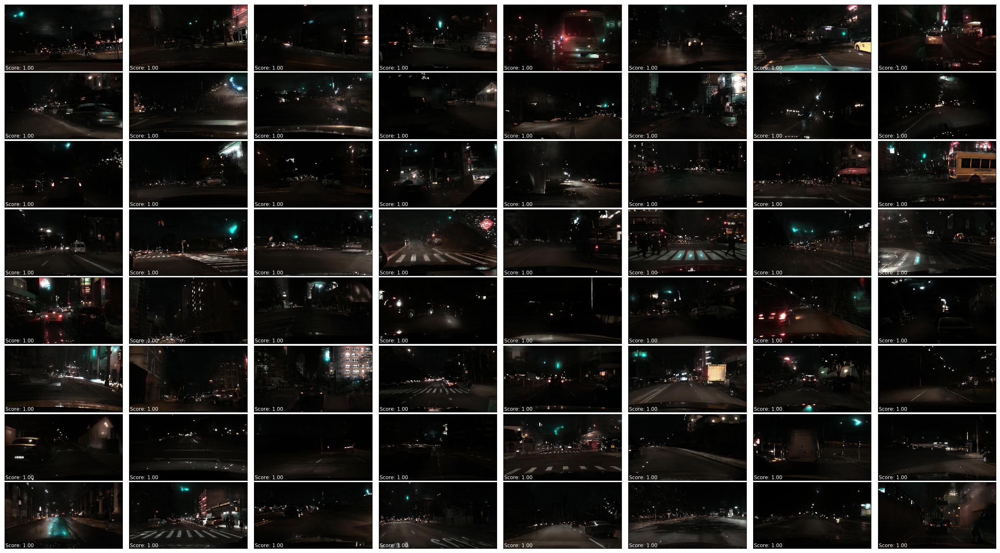

In [11]:
df_converted_good = df_converted.query("label=={}".format(class_dict["night"])).sort_values(by="pred_prob", ascending=False).reset_index(drop=True)
plot_imagegrid(df_converted_good.name.tolist(), show_fig=False, save_name=None, do_shuffle=False, labels=[f"Score: {score:.2f}" for score in df_converted_good.pred_prob.tolist()])

#### Converted day-to-night images with lowest probability score

/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


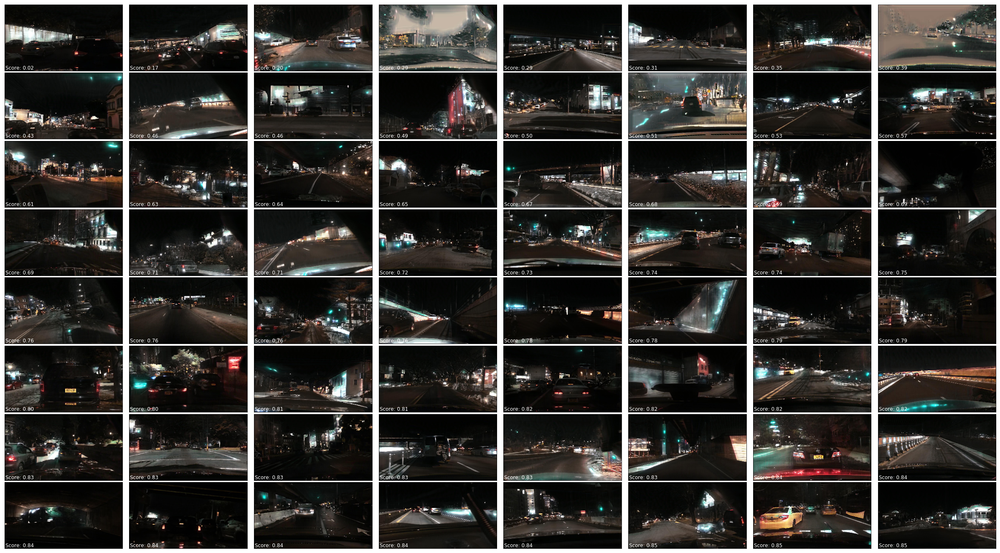

In [12]:
df_converted_bad = df_converted.query("label=={}".format(class_dict["night"])).sort_values(by="pred_prob", ascending=True)
plot_imagegrid(df_converted_bad.name.tolist(), save_name=None, do_shuffle=False, labels=[f"Score: {score:.2f}" for score in df_converted_bad.pred_prob.tolist()])

#### Converted day-to-night images with lowest probability score along with their originals

In [13]:
# a = pd.concat([df_converted_bad.reset_index(drop=True), df_converted_bad_base.reset_index(drop=True)], axis=0)

/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


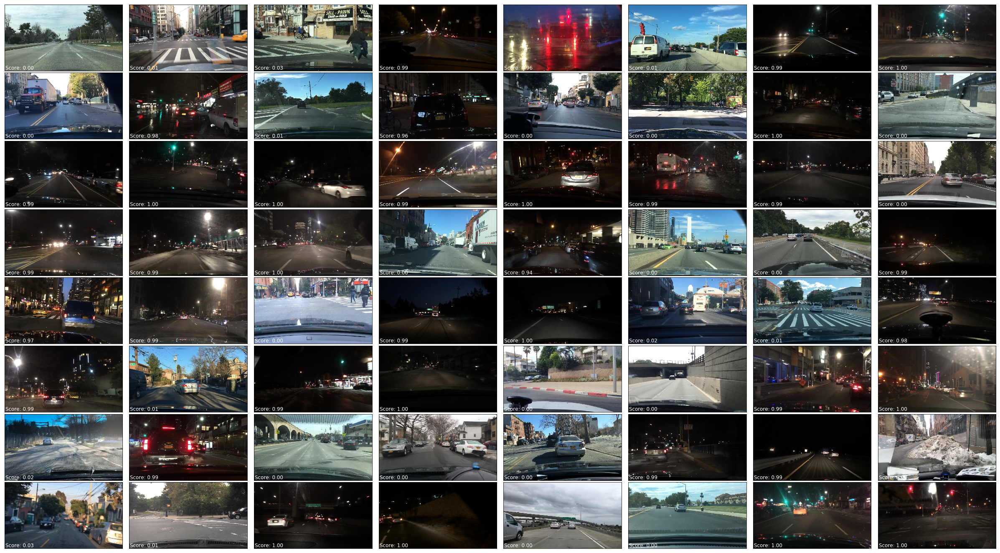

In [14]:
df_converted_bad_base = df_original.loc[df_converted_bad.index,:]
df_converted_bad_merged = pd.concat([df_converted_bad.reset_index(drop=True), df_converted_bad_base.reset_index(drop=True)], axis=0).sort_index(kind='merge')
plot_imagegrid(df_converted_bad_base.name.tolist(), save_name=None, do_shuffle=False, labels=[f"Score: {score:.2f}" for score in df_converted_bad_base.pred_prob.tolist()])

#### Converted "night-to-day" images with highest probability score

/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


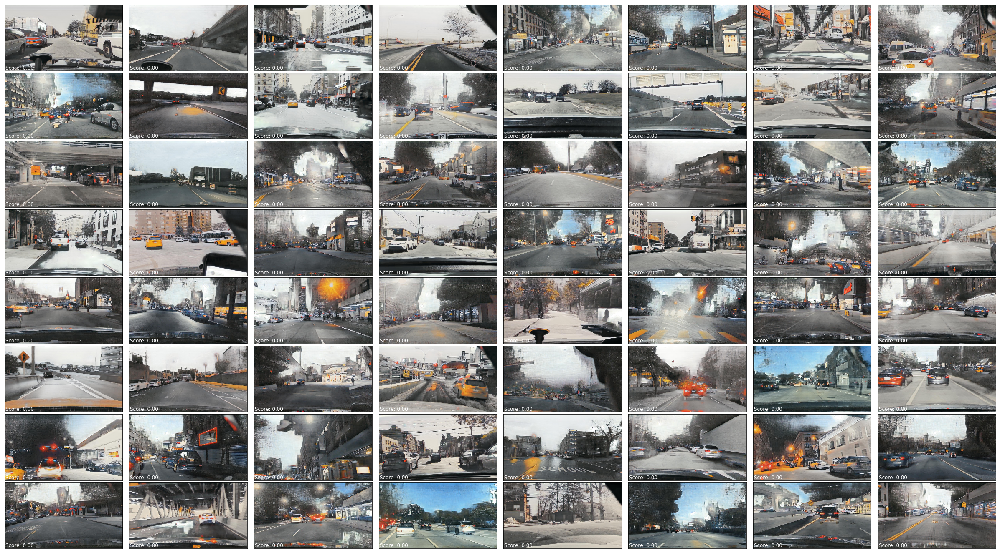

In [15]:
df_original_good = df_converted.query("label=={}".format(class_dict["daytime"])).sort_values(by="pred_prob", ascending=True)
plot_imagegrid(df_original_good.name.tolist(), save_name=None, do_shuffle=False, labels=[f"Score: {score:.2f}" for score in df_original_good.pred_prob.tolist()])

#### Converted "night-to-day" images with lowest probability score

/home/till/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


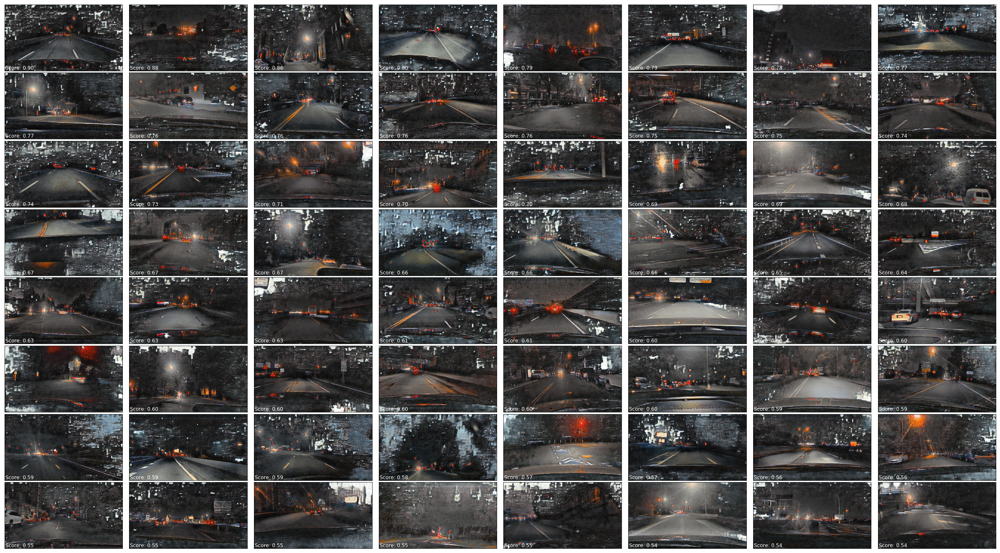

In [16]:
df_original_bad = df_converted.query("label=={}".format(class_dict["daytime"])).sort_values(by="pred_prob", ascending=False)
plot_imagegrid(df_original_bad.name.tolist(), save_name=None, do_shuffle=False, labels=[f"Score: {score:.2f}" for score in df_original_bad.pred_prob.tolist()])